### Zadania

Celem zadań jest napisanie (fragmentów) programów, które wyodrębnią obiekty znajdujące się na podanych obrazach. Rozumie się przez to doprowadzenie obrazów do postaci binarnej z wyraźną separacją między obiektami a tłem oraz poszczególnymi obiektami.

Samo osiągnięcie "jakiegoś" wyniku ([`cv2.threshold`](https://docs.opencv.org/3.4/d7/d1b/group__imgproc__misc.html#gae8a4a146d1ca78c626a53577199e9c57) odpalone, próg wybrany "z palca", _coś tam_ widać, wynik wyświetlony) to co najwyżej połowa sukcesu (i oceny). Ważne jest pokazanie w drodze eksperymentu odpowiedzi na pytania - czy te podane w treści zadania, czy takie, które się Tobie nasunęły.

In [62]:
import cv2
import numpy as np
from PIL import Image

import matplotlib.pyplot as plt

##### Zad. 1: Monety szare

Dane są dwa czarno-białe obrazy monet, `monety_szare` oraz `monety_szare_szum`, z których drugi zawiera pewien poziom zakłóceń. Dokonaj binaryzacji tych obrazów za pomocą progowania.  
W jaki sposób ustalisz wartość progu? Jak wartość progu wpływa na wyniki?  
Jaki wpływ mają zakłócenia w drugim obrazie? Jak się ich pozbędziesz?

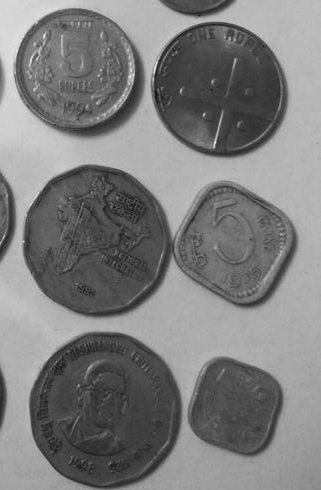

In [63]:
# 1A
monety_szare = cv2.imread('Monety_szare.bmp')
Image.fromarray(cv2.cvtColor(monety_szare, cv2.COLOR_BGR2RGB))

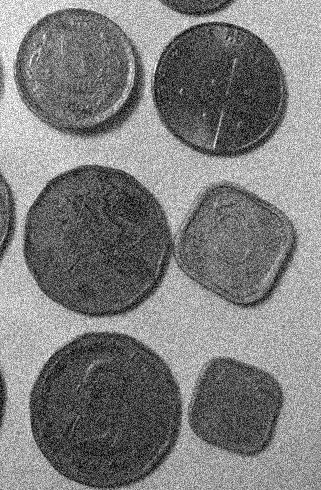

In [64]:
# 1B
monety_szare_szum = cv2.imread('Monety_szare_szum.bmp')
Image.fromarray(cv2.cvtColor(monety_szare_szum, cv2.COLOR_BGR2RGB))

Rozwiązanie części 1A:

In [65]:
def showManyImages(images, width=0):
    if width == 0:
        width = len(images)

    plt.figure(figsize=(25, 15))

    for i, (title, img) in enumerate(images):
        plt.subplot(1 + i//width, len(images), i%width + 1)
        plt.imshow(img, cmap='gray')
        plt.title(title)
        plt.axis('off')
        
    plt.tight_layout()
    plt.show()

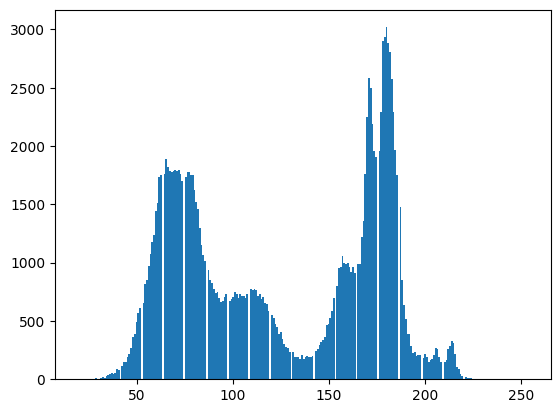

In [66]:
# Zmiana na odcienie szarości dla uproszczenia struktury
monety_szare2 = cv2.cvtColor(monety_szare, cv2.COLOR_BGR2GRAY)

# Zbadanie rozkładu nasycenia
_ = plt.hist(monety_szare2.flatten(), bins=256)

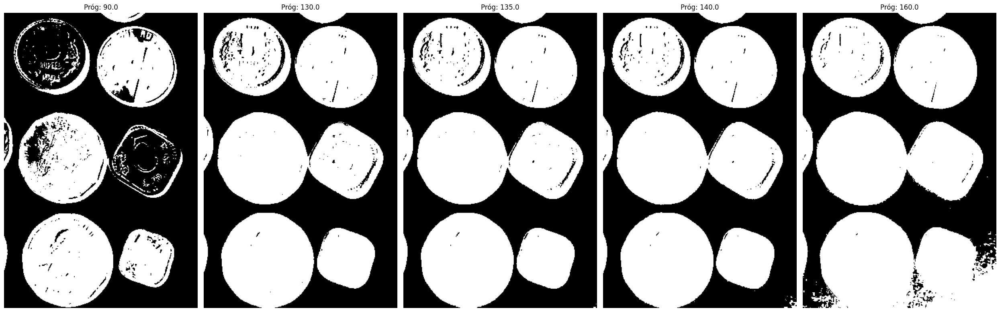

In [67]:
# przetestowanie wartości progów wytypowanych na podstawie minimów lokalnych (na oko) na histogramie
tresholdsToCheck = [90, 130, 135, 140, 160]

images = []
for tresh in tresholdsToCheck:
    (T, monety_szare_threshInv) = cv2.threshold(monety_szare2, tresh, 255, cv2.THRESH_BINARY_INV)
    images.append((f'Próg: {T}', monety_szare_threshInv))

showManyImages(images)

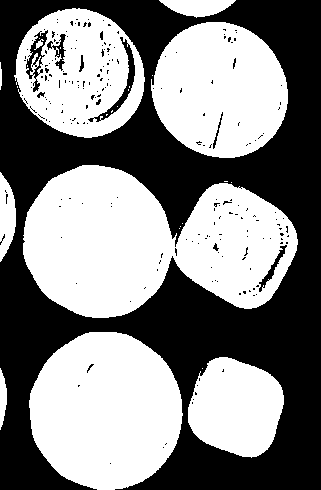

In [68]:
# użycie automatycznego progu OTSU
(T, monety_szare_threshInv) = cv2.threshold(monety_szare2, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)

Image.fromarray(monety_szare_threshInv)

Rozwiązanie części 1B:


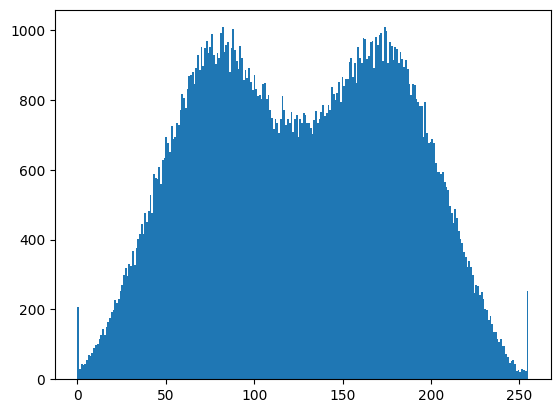

In [69]:
# Zmiana na odcienie szarości dla uproszczenia struktury
monety_szare_szum2 = cv2.cvtColor(monety_szare_szum, cv2.COLOR_BGR2GRAY)

# Zbadanie rozkładu nasycenia
_ = plt.hist(monety_szare_szum2.flatten(), bins=256)

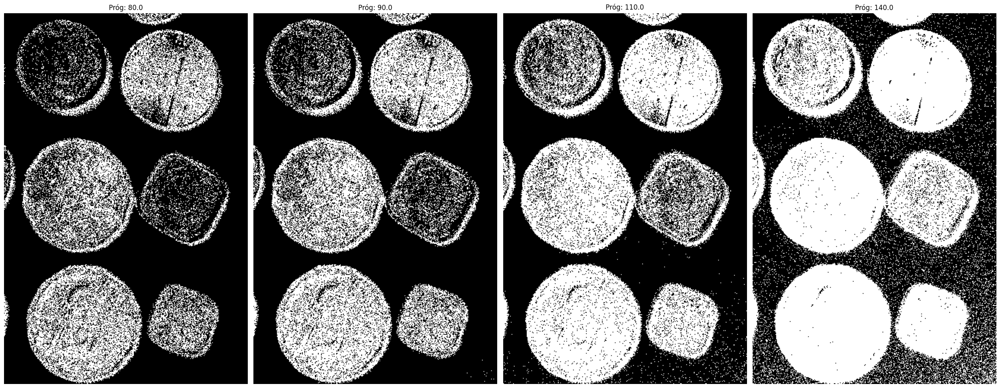

In [70]:
# przetestowanie kilku progów dla zaszumionego obrazka
tresholdsToCheck = [80, 90, 110, 140]

images = []
for tresh in tresholdsToCheck:
    (T, monety_szare_szum_threshInv) = cv2.threshold(monety_szare_szum2, tresh, 255, cv2.THRESH_BINARY_INV)
    images.append((f'Próg: {T}', monety_szare_szum_threshInv))

showManyImages(images)

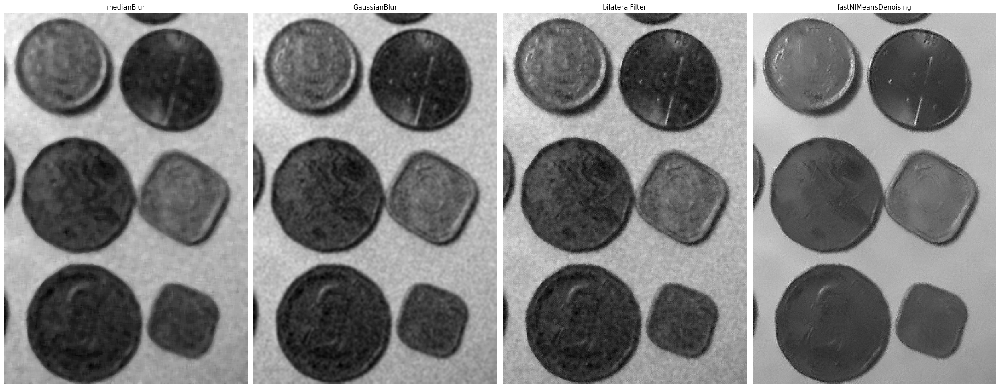

In [71]:
blurFunctions = [("medianBlur", cv2.medianBlur, [7]), ("GaussianBlur", cv2.GaussianBlur, [(7, 7), 0]), ("bilateralFilter", cv2.bilateralFilter, [7, 50, 50]), ("fastNlMeansDenoising", cv2.fastNlMeansDenoising, [None, 20, 7, 21])]

images = []
for title, function, args in blurFunctions:
    img = function(monety_szare_szum2, *args)
    images.append((title, img))

showManyImages(images)

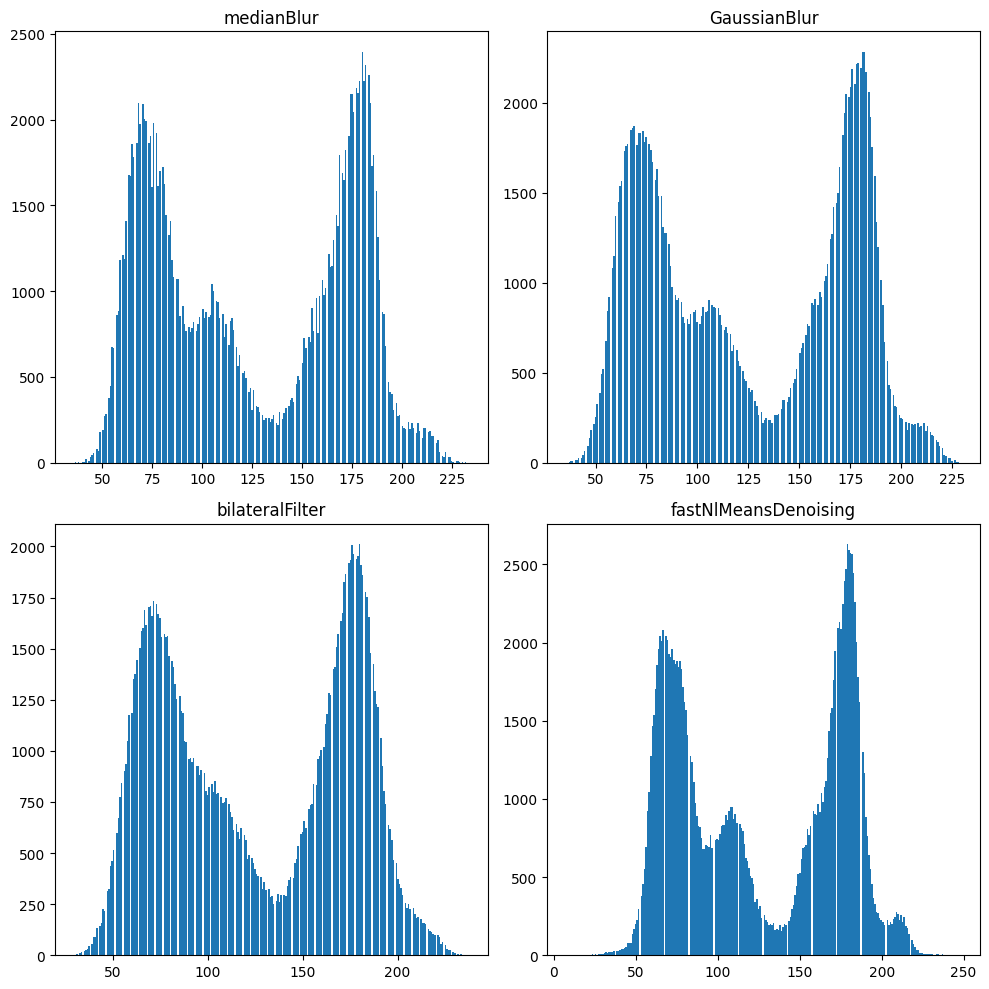

In [72]:
plt.figure(figsize=(10, 10))

for i, (title, img) in enumerate(images):
    plt.subplot(2, 2, i + 1)
    plt.hist(img.flatten(), bins=256)
    plt.title(title)
    
plt.tight_layout()
plt.show()

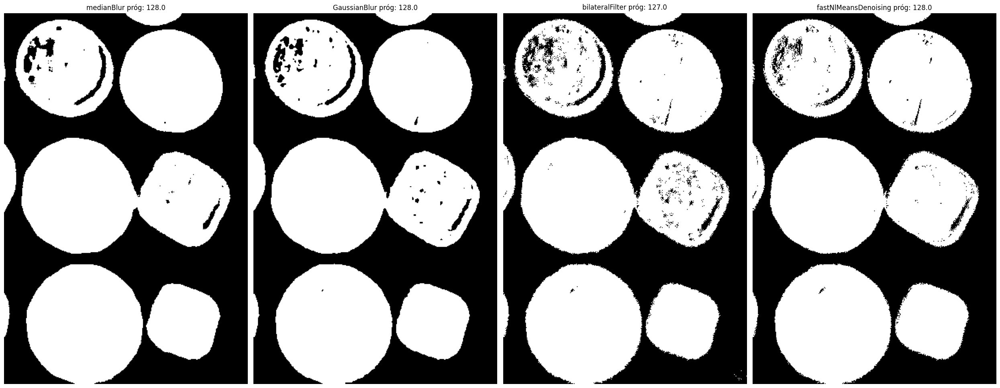

In [73]:
tresholdImages = []
for title, img in images:
    (T, img_tresh) = cv2.threshold(img, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)
    tresholdImages.append((f'{title} próg: {T}', img_tresh))

showManyImages(tresholdImages)

Szum spowodował trudności w odródnieniu całości obiektów od tła, pozostawiając artefakty.

Szum można wyeliminować stosując różne algorytmy do blurowania

##### Zad. 2: Monety kolorowe

Na podobnej zasadzie dokonaj binaryzacji poniższych obrazów kolorowych. Skorzystaj z modelu barw HSV. Uzasadnij dobór progu w oparciu o histogram wybranej składowej.

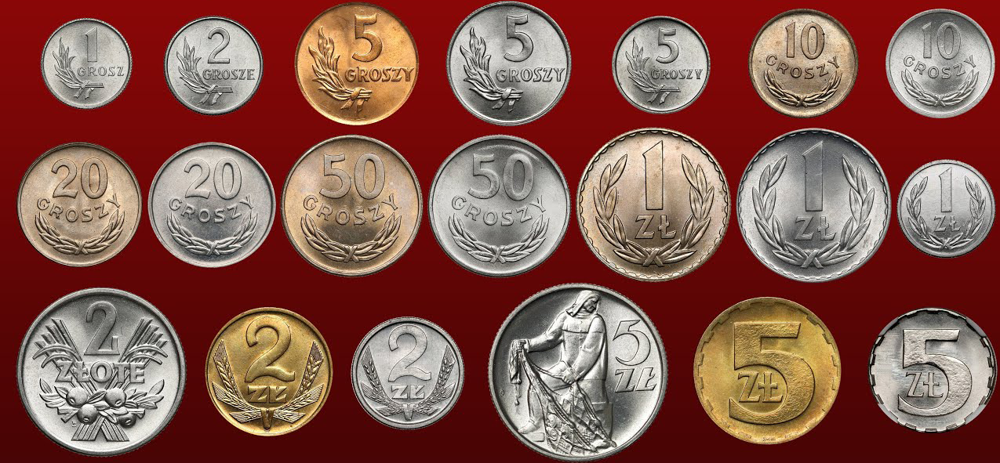

In [74]:
# 2A
monety_kolor = cv2.imread('Monety_kolor.bmp')
Image.fromarray(cv2.cvtColor(monety_kolor, cv2.COLOR_BGR2RGB))

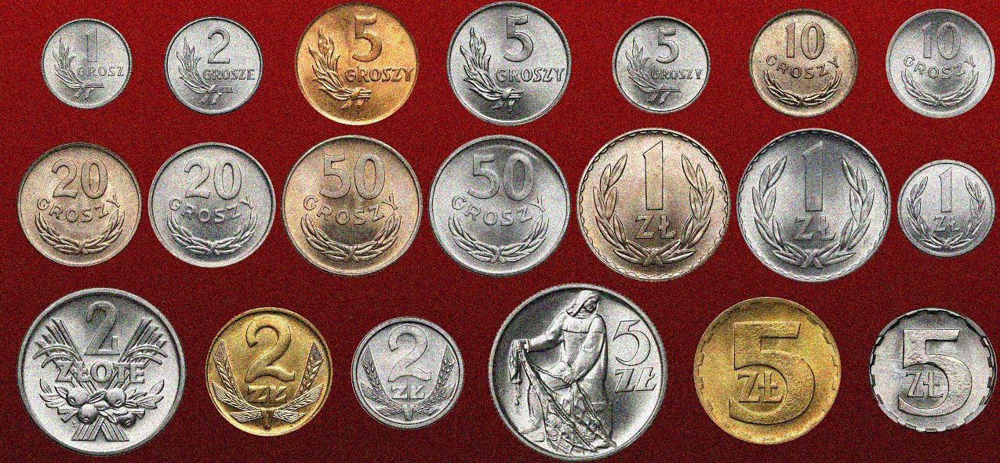

In [75]:
# 2B
monety_kolor_szum = cv2.imread('Monety_kolor_szum.bmp')
Image.fromarray(cv2.cvtColor(monety_kolor_szum, cv2.COLOR_BGR2RGB))

Rozwiązanie części 2A:

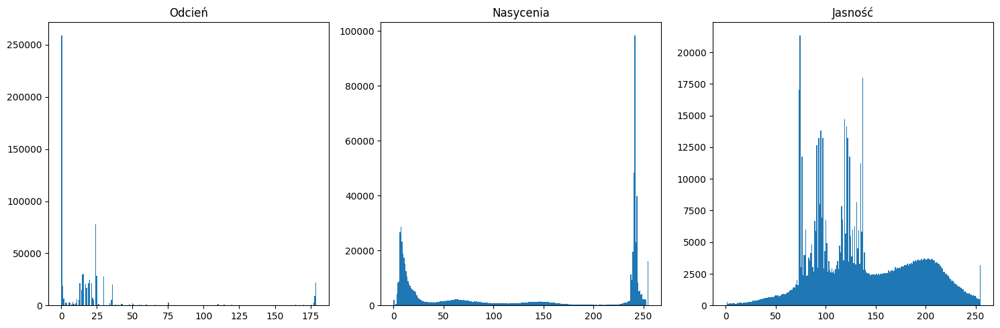

In [76]:
monety_kolor2 = cv2.cvtColor(monety_kolor, cv2.COLOR_BGR2HSV)

plt.figure(figsize=(15, 5))

for i, canal in enumerate(["Odcień", "Nasycenia", "Jasność"]):
    plt.subplot(1, 3, i + 1)
    plt.hist(monety_kolor2[:, :, i].flatten(), bins=256)
    plt.title(canal)
    
plt.tight_layout()
plt.show()

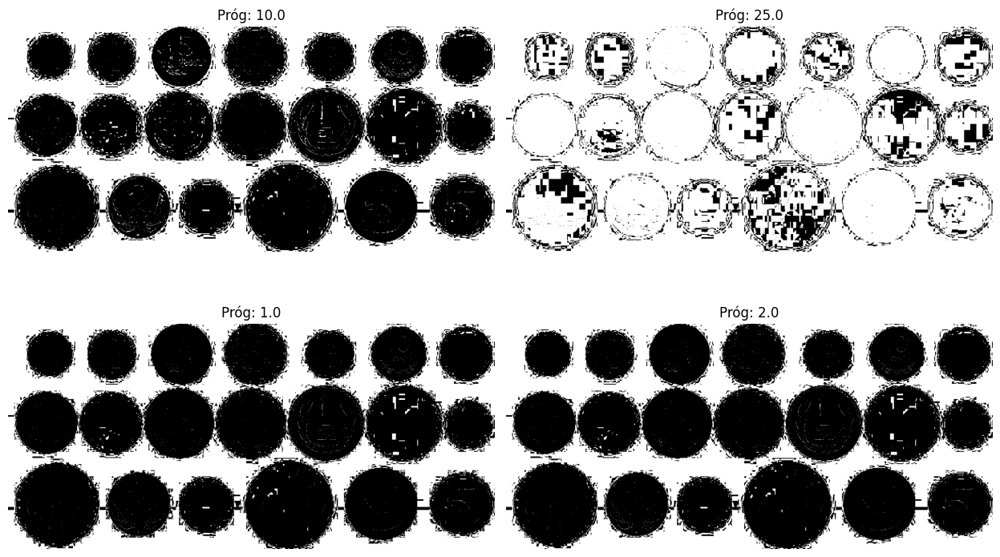

Próg: 92.0


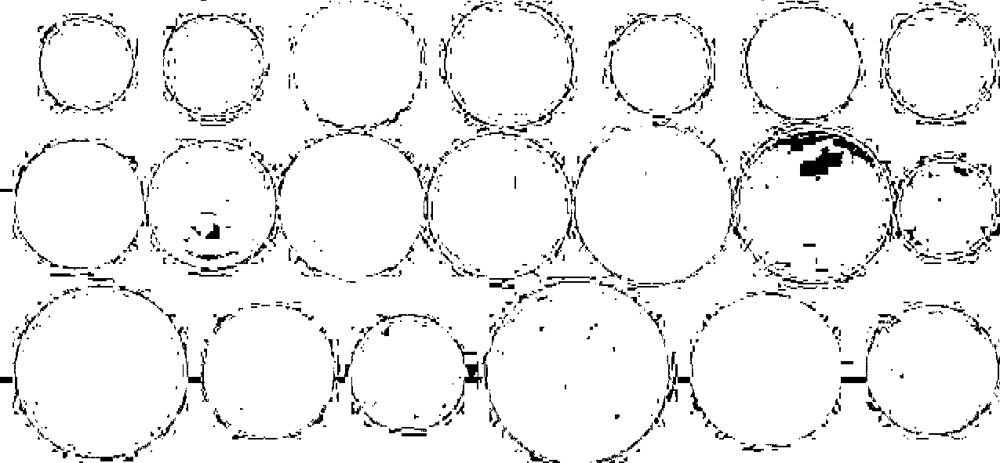

In [77]:
# zbadanie działania odcieniu
tresholdsToCheck = [1, 2, 10, 25]

monety_H = monety_kolor2[:, :, 0]

images = []
for tresh in tresholdsToCheck:
    (T, monety_H_threshInv) = cv2.threshold(monety_H, tresh, 255, cv2.THRESH_BINARY_INV)
    images.append((f'Próg: {T}', monety_H_threshInv))

showManyImages(images, 2)

(T, monety_H_threshInv) = cv2.threshold(monety_H, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)
print(f"Próg: {T}")
Image.fromarray(monety_H_threshInv)

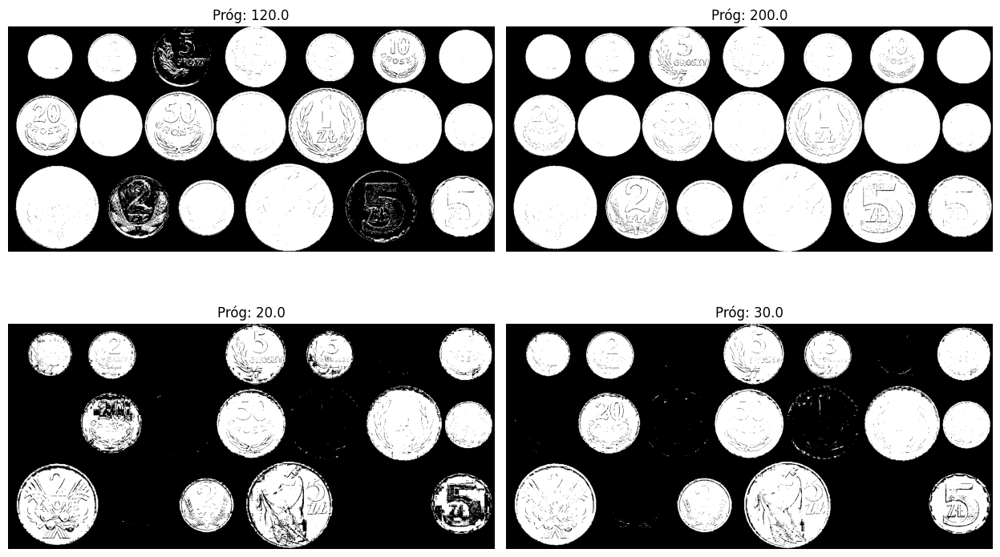

Próg: 131.0


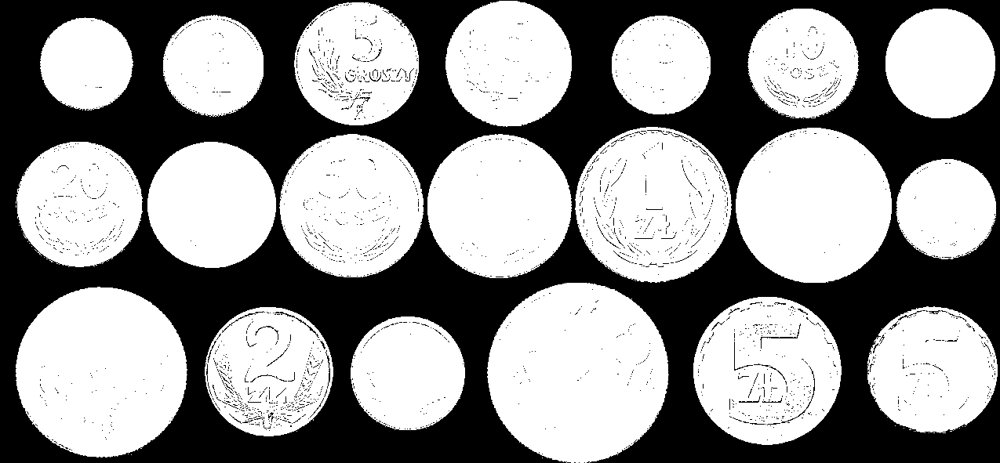

In [78]:
# badanie działania nasycenia
tresholdsToCheck = [20, 30, 120, 200]

monety_S = monety_kolor2[:, :, 1]

images = []
for tresh in tresholdsToCheck:
    (T, monety_S_threshInv) = cv2.threshold(monety_S, tresh, 255, cv2.THRESH_BINARY_INV)
    images.append((f'Próg: {T}', monety_S_threshInv))

showManyImages(images, 2)

(T, monety_H_threshInv) = cv2.threshold(monety_S, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)
print(f"Próg: {T}")
Image.fromarray(monety_S_threshInv)

Rozwiązanie części 2B:


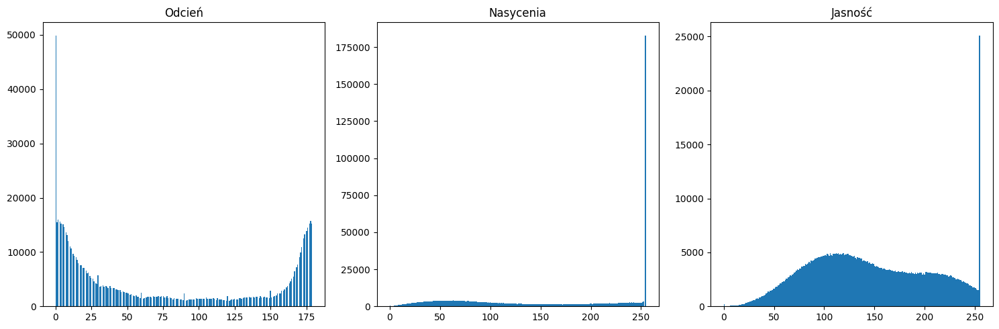

In [79]:
monety_kolor_szum2 = cv2.cvtColor(monety_kolor_szum, cv2.COLOR_BGR2HSV)

plt.figure(figsize=(15, 5))

for i, canal in enumerate(["Odcień", "Nasycenia", "Jasność"]):
    plt.subplot(1, 3, i + 1)
    plt.hist(monety_kolor_szum2[:, :, i].flatten(), bins=256)
    plt.title(canal)
    
plt.tight_layout()
plt.show()

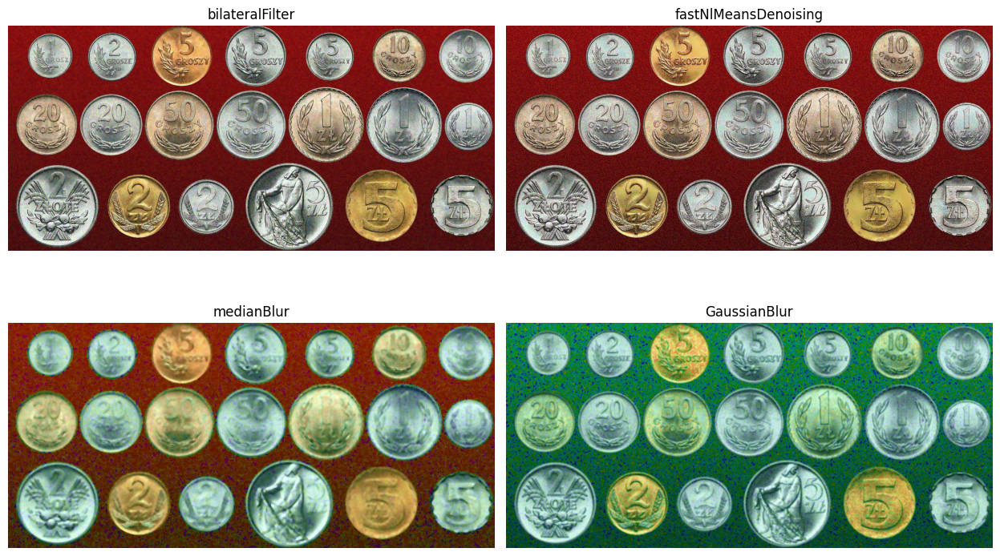

In [80]:
blurFunctions = [("medianBlur", cv2.medianBlur, [7]), ("GaussianBlur", cv2.GaussianBlur, [(7, 7), 0]), ("bilateralFilter", cv2.bilateralFilter, [7, 50, 50]), ("fastNlMeansDenoising", cv2.fastNlMeansDenoising, [None, 20, 7, 21])]

images = []
for title, function, args in blurFunctions:
    img = function(monety_kolor_szum2, *args)
    images.append((title, img))

images_bgr = [(title, cv2.cvtColor(img, cv2.COLOR_HSV2RGB)) for title, img in images]

showManyImages(images_bgr, 2)

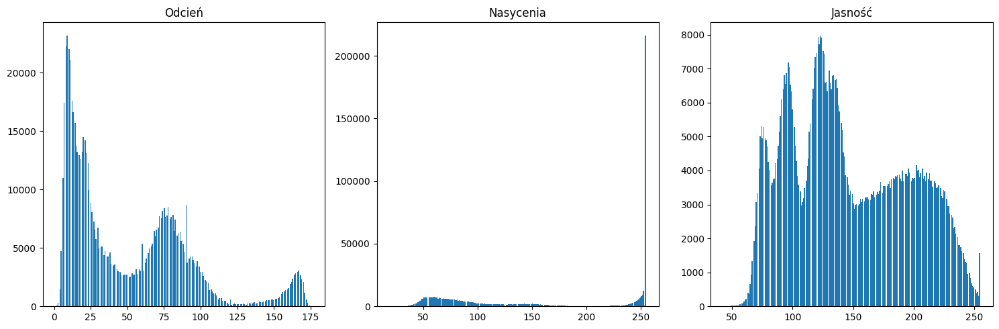

In [81]:
plt.figure(figsize=(15, 5))

for i, canal in enumerate(["Odcień", "Nasycenia", "Jasność"]):
    plt.subplot(1, 3, i + 1)
    plt.hist(images[0][1][:, :, i].flatten(), bins=256)
    plt.title(canal)
    
plt.tight_layout()
plt.show()

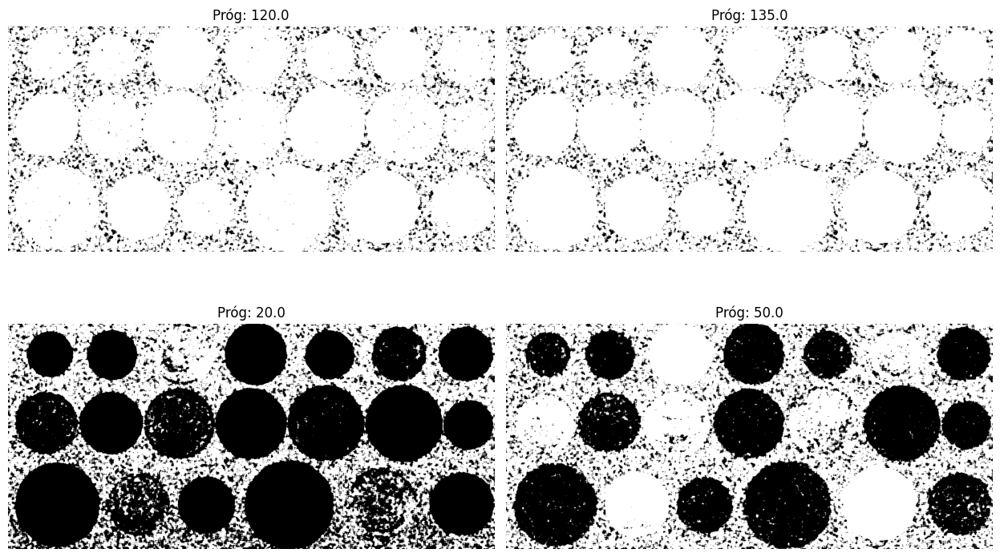

Próg: 56.0


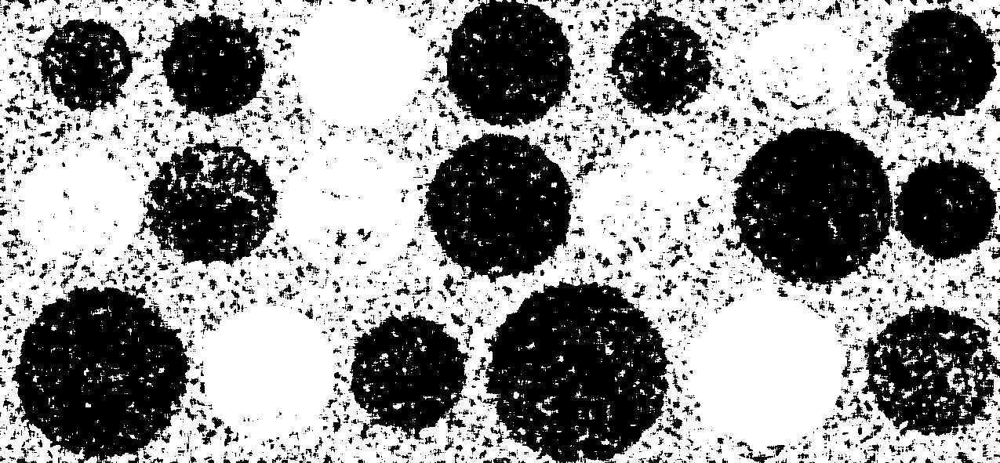

In [82]:
# zbadanie działania odcieniu
tresholdsToCheck = [20, 50, 120, 135]

image = images[0][1]
monety_H = image[:, :, 0]

images_tresh = []
for tresh in tresholdsToCheck:
    (T, monety_H_threshInv) = cv2.threshold(monety_H, tresh, 255, cv2.THRESH_BINARY_INV)
    images_tresh.append((f'Próg: {T}', monety_H_threshInv))

showManyImages(images_tresh, 2)

(T, monety_H_threshInv) = cv2.threshold(monety_H, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)
print(f"Próg: {T}")
Image.fromarray(monety_H_threshInv)

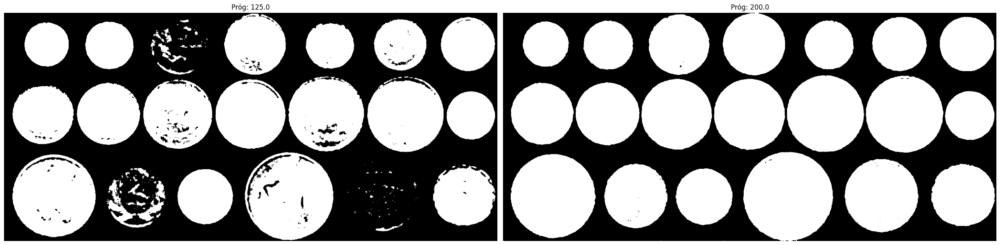

Próg: 166.0


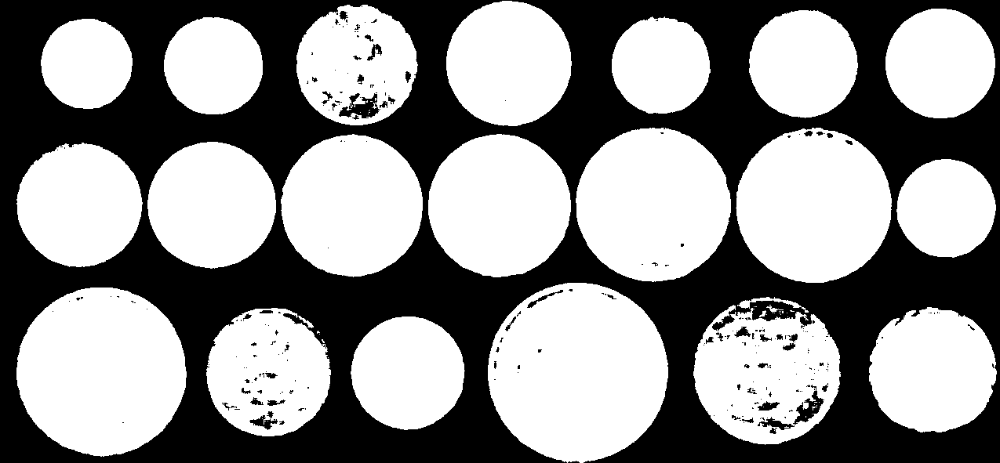

In [83]:
# zbadanie działania nasycenia
tresholdsToCheck = [125, 200]

image = images[0][1]
monety_S = image[:, :, 1]

images_tresh = []
for tresh in tresholdsToCheck:
    (T, monety_S_threshInv) = cv2.threshold(monety_S, tresh, 255, cv2.THRESH_BINARY_INV)
    images_tresh.append((f'Próg: {T}', monety_S_threshInv))

showManyImages(images_tresh)

(T, monety_S_threshInv) = cv2.threshold(monety_S, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)
print(f"Próg: {T}")
Image.fromarray(monety_S_threshInv)

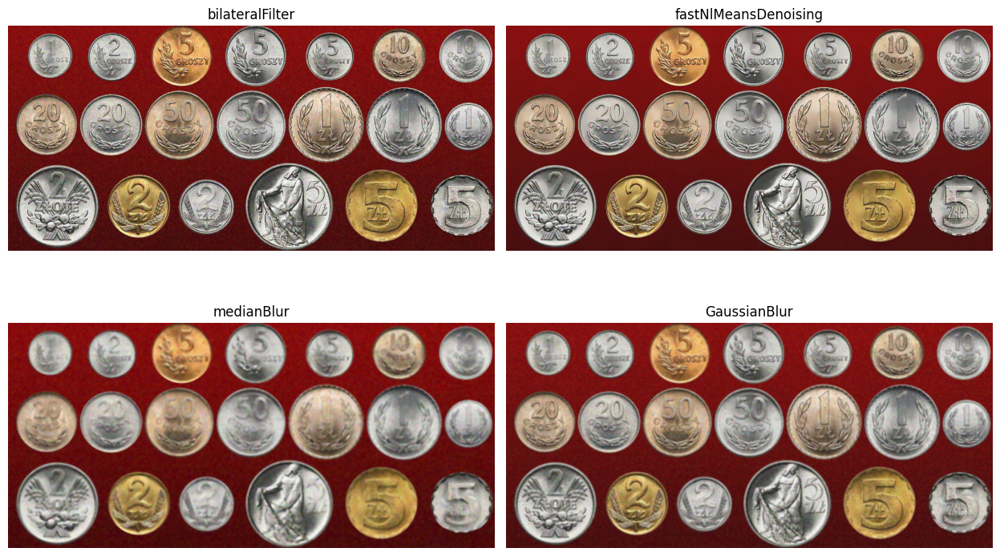

In [88]:
blurFunctions = [("medianBlur", cv2.medianBlur, [7]), ("GaussianBlur", cv2.GaussianBlur, [(7, 7), 0]), ("bilateralFilter", cv2.bilateralFilter, [7, 50, 50]), ("fastNlMeansDenoising", cv2.fastNlMeansDenoising, [None, 20, 7, 21])]

images = []
for title, function, args in blurFunctions:
    img = function(monety_kolor_szum, *args)
    images.append((title, img))

images_bgr = [(title, cv2.cvtColor(img, cv2.COLOR_BGR2RGB)) for title, img in images]

showManyImages(images_bgr, 2)

Progi zostały wyznaczone w wartościach w pobliżu minimumów lokalnych na histogramach, oddalone od szczytów.

##### Zad. 3: Tekst

W tym przypadku należy wyodrębnić litery od bardzo nierównomiernie oświetlonego tła. Skorzystaj z binaryzacji metodą Otsu. Zastosuj binaryzację w sposób lokalny (oknem przesuwnym). Jaki wpływ ma rozmiar okna na jakość binaryzacji? Jak przesuwać okno?

_(Pełna punktacja za zadanie wymaga własnoręcznej implementacji okna przesuwnego i filtracji wewnątrz niego. Użycie zamiast tego_ `cv2.adaptiveThreshold` _liczone jako pół zadania, przy założeniu zrozumienia tej metody.)_

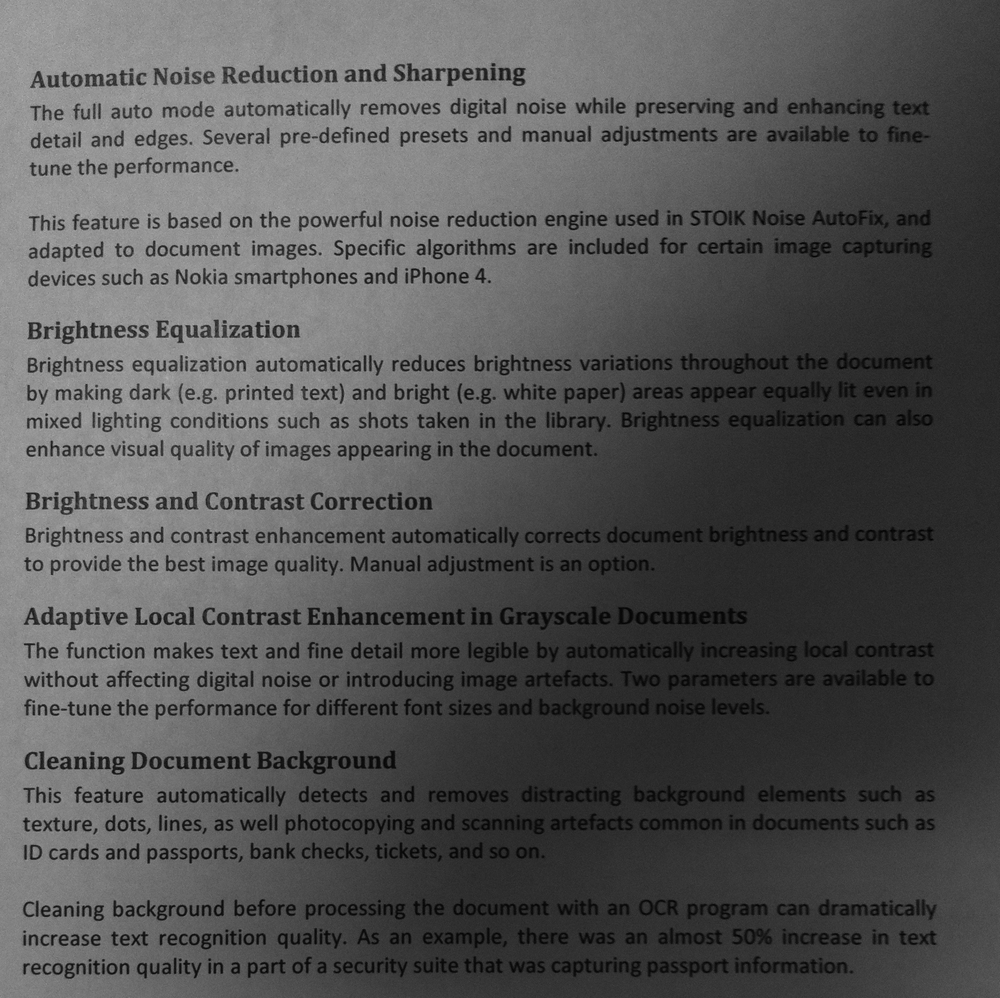

In [55]:
tekst = cv2.imread('Tekst1.bmp')
Image.fromarray(cv2.cvtColor(tekst, cv2.COLOR_BGR2GRAY))

Rozwiązanie:

In [71]:
def adaptiveThreshold(img, windowSize, extraTrasholdValue = 0):
    h, w = img.shape

    newImage = np.zeros_like(img)

    windowHalfSize = windowSize // 2

    for i in range(h):
        for j in range(w):
            
            window = img[max(i - windowHalfSize, 0) : min(i + windowHalfSize + 1, h), max(j - windowHalfSize, 0) : min(j + windowHalfSize + 1, w)]

            threshold, _ = cv2.threshold(window, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
            newImage[i, j] = 255 if img[i, j] + extraTrasholdValue > threshold else 0

    return newImage

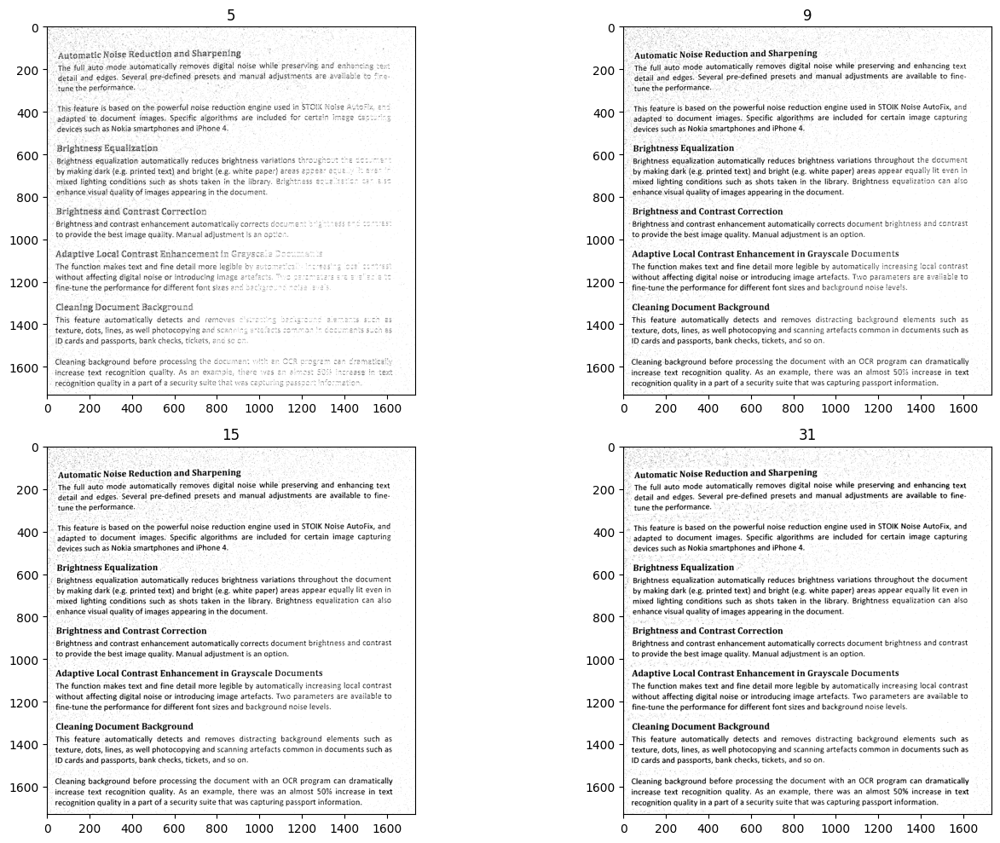

In [74]:
tekst2 = cv2.cvtColor(tekst, cv2.COLOR_BGR2GRAY)

windowSizes = [5, 9, 15, 31]

plt.figure(figsize=(15, 10))

for i, windowSize in enumerate(windowSizes):
    plt.subplot(2, 2, i + 1)
    plt.imshow(adaptiveThreshold(tekst2, windowSize, 10), cmap='gray')
    plt.title(windowSize)
    
plt.tight_layout()
plt.show()

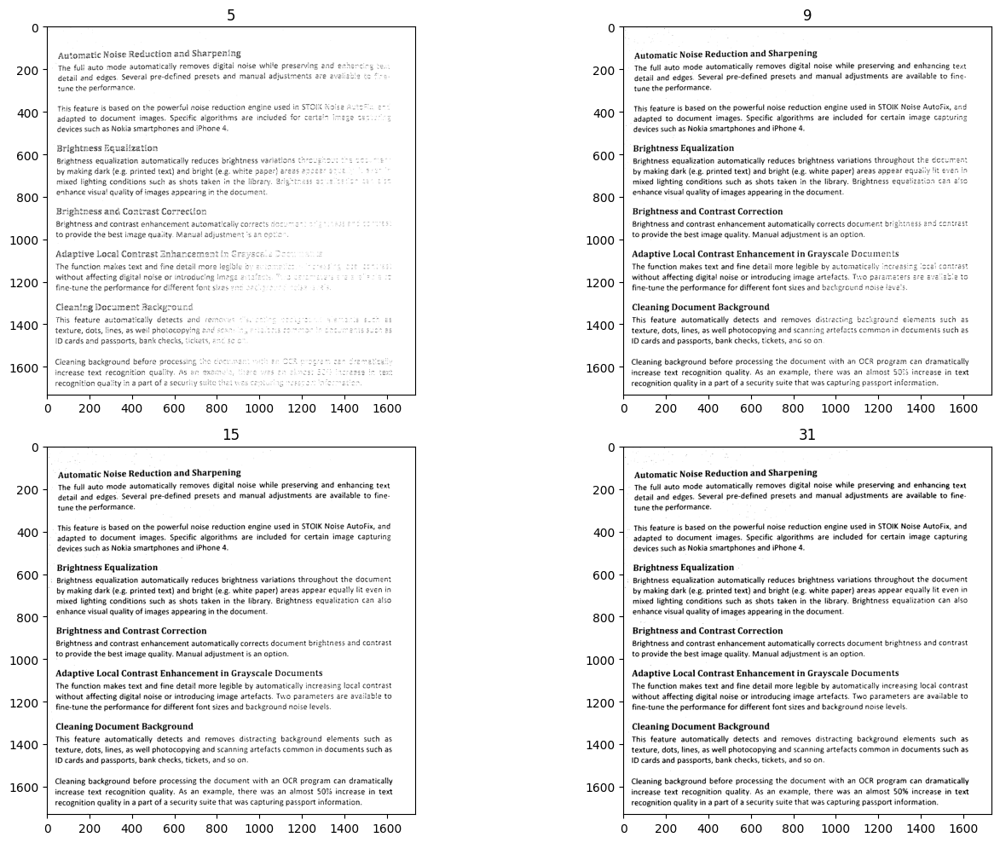

In [76]:
tekst3 = cv2.medianBlur(cv2.cvtColor(tekst, cv2.COLOR_BGR2GRAY), 3)

windowSizes = [5, 9, 15, 31]

plt.figure(figsize=(15, 10))

for i, windowSize in enumerate(windowSizes):
    plt.subplot(2, 2, i + 1)
    plt.imshow(adaptiveThreshold(tekst3, windowSize, 10), cmap='gray')
    plt.title(windowSize)
    
plt.tight_layout()
plt.show()

Ustawienie za małego okna powoduje, że obszary oddalone od tekstu rozważają przy ustalaniu progu jedynie tło, przez co w progowaniu zostają wyszczególnione cimniejsze miejsca tła w oknie, w tym przypadku wychodzą artefakty związane z szumem na zdjęciu. Problem został rozwiązany przez lekkie wyblurowanie obrazu, aby nie tracić ostrości, ale zmniejszyć szum i dodanie do automatycznie ustalanego progu dodatkową wartość dzięki której elementy nie będące wyraźnie ciemniejsze nie będą wykrywane.

Zbyt duże okno powoduje zwiększenie nakładu obliczeniowego i zatracenie umiejętności wykrywania tła przy nierównomiernym oświetleniu

Okno przesuwne powinno być przesuwane w obu wymiarach i rozważać dla piksela obszar, którego jest centrum. Można opcjonalnie wprowadzić skok dla zmniejszenia liczby wyliczeń skoku